In [24]:
import snapatac2 as snap
import scanpy as sc
import pickle
import os
import pandas as pd

### Load in the filtered/re-annotated peak matrix

In [2]:
%%time
peak_mat = sc.read_h5ad("06D_filtered_peak_matrix.h5ad")
peak_mat

CPU times: user 3.79 s, sys: 21.9 s, total: 25.7 s
Wall time: 25.7 s


AnnData object with n_obs × n_vars = 690044 × 654221
    obs: 'ATAC_barcode', 'sample_id', 'leiden', 'donor_id', 'study', 'age_status', 'age', 'sex', 'region', 'disease_binary', 'technology', 'fragment_file', 'full_path', 'file', 'nfrag', 'tsse', 'cell_type', 'tech_plus_study'
    var: 'count', 'selected'
    uns: 'age_status_colors', 'cell_type_colors', 'leiden', 'leiden_colors', 'neighbors', 'spectral_eigenvalue', 'study_colors'
    obsm: 'X_spectral', 'X_spectral_harmony', 'X_umap'
    obsp: 'connectivities', 'distances'

### Obtain marker peaks

In [3]:
%%time
marker_peaks = snap.tl.marker_regions(peak_mat, groupby='cell_type', pvalue=0.01)

CPU times: user 13min 45s, sys: 1min 16s, total: 15min 1s
Wall time: 15min 2s


In [4]:
# save as pickle object 
marker_peaks_path = "06E_marker_peaks_by_cell_type.pkl"

with open(marker_peaks_path, 'wb') as file:
    pickle.dump(marker_peaks, file)
    
print(f"Data saved to {marker_peaks_path}")

Data saved to 06E_marker_peaks_by_cell_type.pkl


### Produce plot in this notebook

2025-01-06 22:09:37 - WARNING - Input contains 216858 peaks, only 50000 peaks will be plotted.


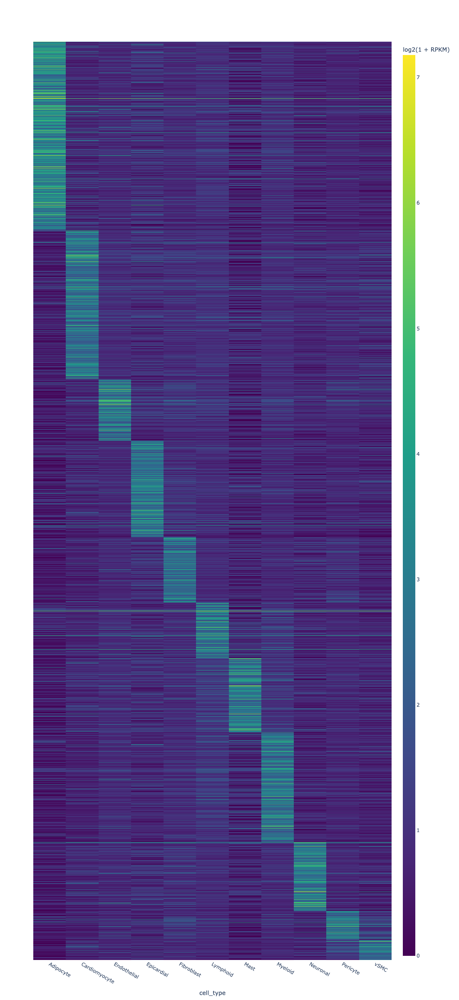

CPU times: user 13min 33s, sys: 3min 1s, total: 16min 34s
Wall time: 16min 37s


In [5]:
%%time
snap.pl.regions(peak_mat, groupby='cell_type', peaks=marker_peaks, interactive=True, height = 2400)

### Also produce plot for paper figures

2025-01-06 22:26:14 - WARNING - Input contains 216858 peaks, only 50000 peaks will be plotted.


CPU times: user 13min 43s, sys: 4min 4s, total: 17min 48s
Wall time: 18min


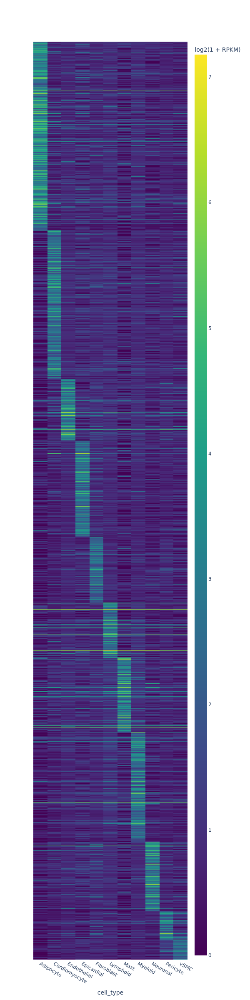

In [6]:
%%time
snap.pl.regions(peak_mat, groupby='cell_type', peaks=marker_peaks, interactive=False, height = 2400,
               out_file = "../../paper_figures/snATAC_seq_marker_peaks.pdf")

### Perform motif enrichment

In [7]:
%%time
motifs = snap.tl.motif_enrichment(
    motifs=snap.datasets.cis_bp(unique=True),
    regions=marker_peaks,
    genome_fasta=snap.genome.hg38,
)

2025-01-06 22:44:14 - INFO - Fetching 216858 sequences ...
2025-01-06 22:44:45 - INFO - Computing enrichment ...
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1165/1165 [14:50<00:00,  1.31it/s]

CPU times: user 9h 53min 15s, sys: 5min 45s, total: 9h 59min
Wall time: 15min 21s


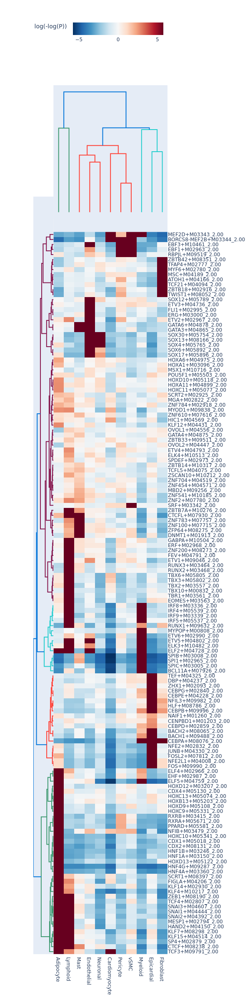

In [8]:
snap.pl.motif_enrichment(motifs, max_fdr=0.0001, height=2400, interactive=False, 
                         out_file = "../../paper_figures/snATAC_enriched_motifs.pdf")

In [9]:
motifs_gene_file_path = "06E_motifs_by_cell_type.pkl"

with open(motifs_gene_file_path, 'wb') as file:
    pickle.dump(motifs, file)
print(f"Data saved to {motifs_gene_file_path}")

Data saved to 06E_motifs_by_cell_type.pkl


### Save these motifs in csv format

In [26]:
cell_types = peak_mat.obs.cell_type.unique()
motifs_dir = "motifs_per_cell_type/"
os.makedirs(motifs_dir, exist_ok=True)

In [27]:
for cell_type in cell_types:
    motif_df = motifs[cell_type]
    motif_df = pd.DataFrame(motif_df)
    motif_df.to_csv(motifs_dir + cell_type + "_significant_motifs.csv")

AttributeError: 'DataFrame' object has no attribute 'to_csv'

In [28]:
pd.DataFrame(motif_df)

,0,1,2,3,4,5
0,AC023509.3+M02872_2.00,AC023509.3,NaN,-0.627394,0.000198,0.000692
1,AC138696.1+M04597_2.00,AC138696.1,NaN,-0.119307,0.038971,0.070063
2,AHR+M09817_2.00,AHR,NaN,-0.150704,0.183729,0.244902
3,AIRE+M09375_2.00,AIRE,NaN,0.07764,0.045564,0.079227
4,ALX1+M05327_2.00,ALX1,NaN,-0.058253,0.109248,0.160295
...,...,...,...,...,...,...
1160,ZSCAN4+M02919_2.00,ZSCAN4,NaN,0.105966,0.00464,0.011357
1161,ZSCAN5+M04460_2.00,ZSCAN5,NaN,0.016711,0.33277,0.381879
1162,ZSCAN5C+M08390_2.00,ZSCAN5C,NaN,0.142538,0.000903,0.002784
1163,ZSCAN9+M04466_2.00,ZSCAN9,NaN,-0.06216,0.060789,0.10146
